In [1]:
# import the required libraries and login to Hugging Face to download the model and use diffusers library
import logging
from pathlib import Path

import matplotlib.pyplot as plt
import torch
from diffusers import StableDiffusionPipeline
from fastcore.all import concat
from huggingface_hub import notebook_login
from PIL import Image

logging.disable(logging.WARNING)

torch.manual_seed(1)
if not (Path.home()/'.cache/huggingface'/'token').exists(): notebook_login()

In [2]:
# Use Stable Diffusion Pipeline to do diffusion inference and generate images

pipe = StableDiffusionPipeline.from_pretrained("CompVis/stable-diffusion-v1-4", variant="fp16", torch_dtype=torch.float16).to("cuda")

/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


model_index.json:   0%|          | 0.00/541 [00:00<?, ?B/s]

Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

scheduler_config.json:   0%|          | 0.00/313 [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

scheduler_config-checkpoint.json:   0%|          | 0.00/209 [00:00<?, ?B/s]

config.json: 0.00B [00:00, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/592 [00:00<?, ?B/s]

safety_checker/model.fp16.safetensors:   0%|          | 0.00/608M [00:00<?, ?B/s]

text_encoder/model.fp16.safetensors:   0%|          | 0.00/246M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/743 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/551 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

unet/diffusion_pytorch_model.fp16.safete(…):   0%|          | 0.00/1.72G [00:00<?, ?B/s]

vae/diffusion_pytorch_model.fp16.safeten(…):   0%|          | 0.00/167M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [3]:
# check if the model weights are cached
!ls ~/.cache/huggingface/hub

models--CompVis--stable-diffusion-v1-4


In [4]:
# Image generation prompt
prompt = "oil painting of a goat tied to a tree in the style of van gogh's starry night"

  0%|          | 0/50 [00:00<?, ?it/s]

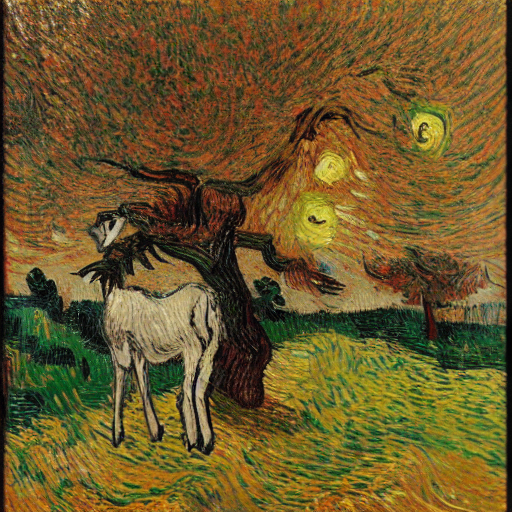

In [5]:
# pass the prompt to the pipe
pipe(prompt, guidance_scale = 7.5).images[0]

The inference runs for 50 steps because diffusion is a progressive denoising algorithm which takes a multi-step approach

  0%|          | 0/3 [00:00<?, ?it/s]

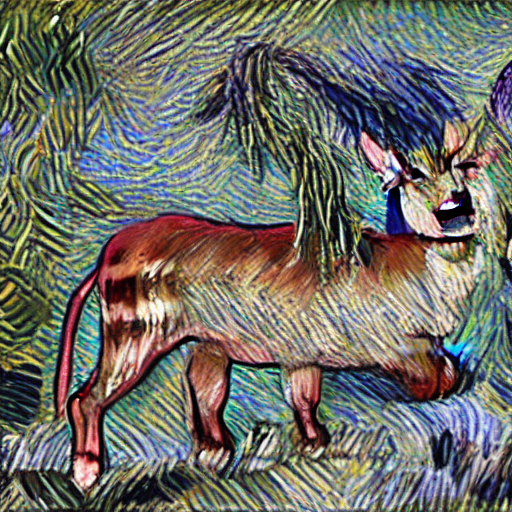

In [ ]:
# reducing the inference steps to 3
pipe(prompt, num_inference_steps=3).images[0]

Reducing the inference steps, we see that the image is not good.it looks incomplete and we also see that the animal is close to deer

  0%|          | 0/100 [00:00<?, ?it/s]

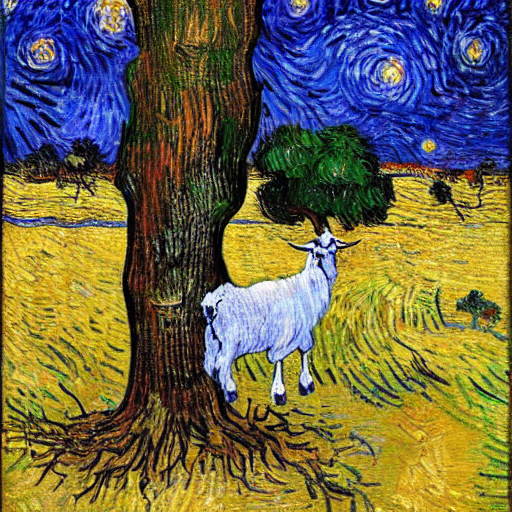

In [ ]:

# increasing the inference_steps to 100
pipe(prompt, guidance_scale = 7.5, num_inference_steps=100).images[0]

Classifier free guidance:
Diffusion models by themselves generate images of different variety. Prompting the model makes it adhere to the prompt and restrict diversity of outputs. There is an option to make it flexible. A score is assigned instructing the model to adhere to the prompt partially.

In [7]:
def image_grid(images, rows, cols):
  w,h = images[0].size
  grid = Image.new('RGB', size=(w * cols, h * rows))
  for i, image in enumerate(images) : grid.paste(image, box=(i%cols * w, i//cols * h))
  return grid


In [ ]:
num_rows, num_cols = 4,4 # 4X4 grid
prompts = [prompt] * num_cols

In [ ]:
images = concat(pipe(prompts, guidance_scale = g).images for g in [1.1, 3, 7, 15])

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

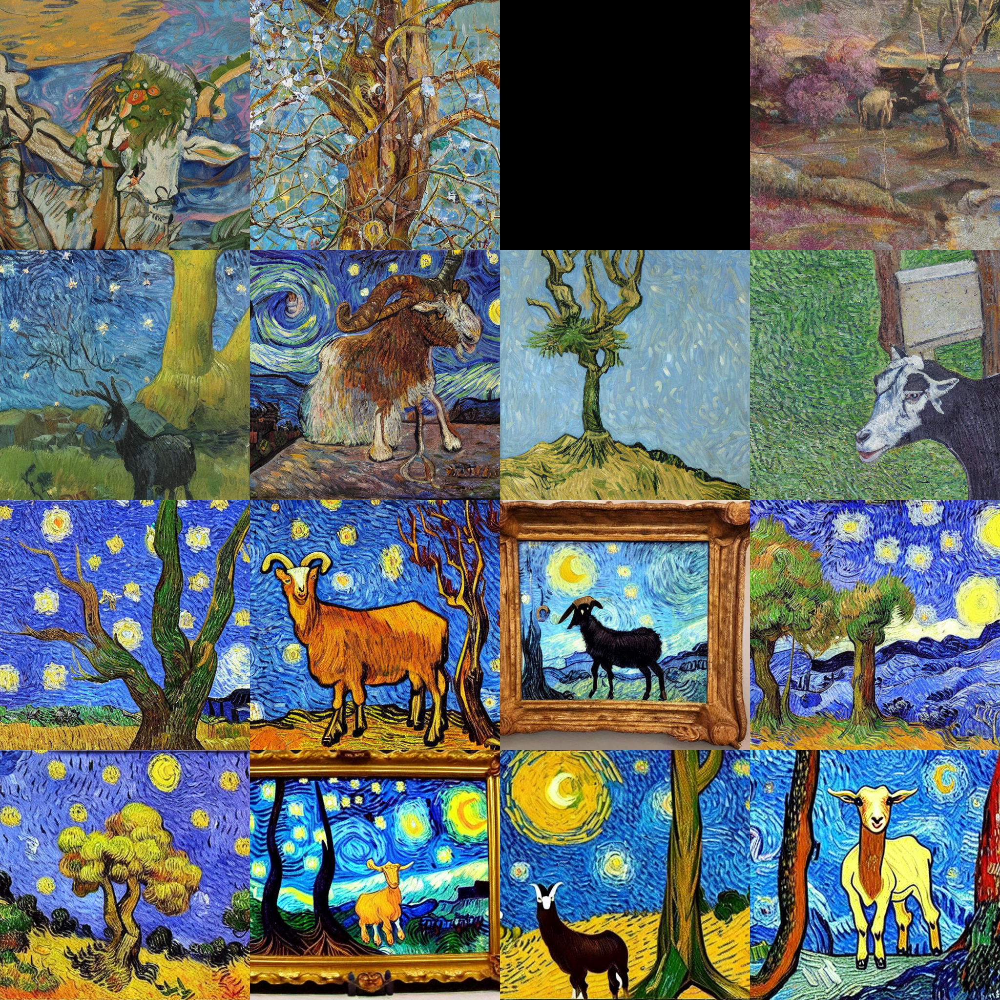

In [ ]:
image_grid(images, num_rows, num_cols)

  0%|          | 0/50 [00:00<?, ?it/s]

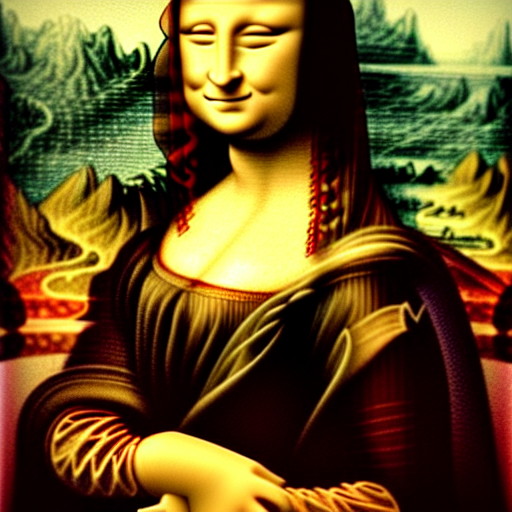

In [ ]:
# negative prompting - to remove certain elements from the image through prompts
torch.manual_seed(42)
prompt = "Mona lisa in the style of Da Vinci"
pipe(prompt).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

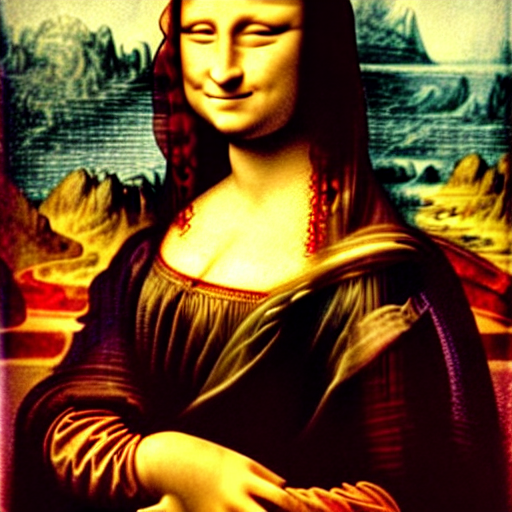

In [ ]:
torch.manual_seed(42)
pipe(prompt, negative_prompt = "green").images[0]

Textual inversion : A very useful trick where a new word can be added to the text encoder's vocabulary so that with just some fine-tuning, the stable model' base diffusion model learns to use this new word and generate relevant images accordingly.

Already, the tokens have been trained by freezing the model weights keeping the text encoder alone learnable. We could just add this token with its embedding with the pipe's embeddings.

In [ ]:
# download token embeddings learned on a bunch of indian water color paintings
!pip install fastdownload
from fastdownload import FastDownload
embeds_url = "https://huggingface.co/sd-concepts-library/indian-watercolor-portraits/resolve/main/learned_embeds.bin"
embeds_path = FastDownload().download(embeds_url)
embeds_dict = torch.load(str(embeds_path), map_location="cpu")

In [ ]:
tokenizer = pipe.tokenizer
text_encoder = pipe.text_encoder


In [ ]:
embeds_dict.keys()

dict_keys(['<watercolor-portrait>'])

the new token is 'watercolor-portrait'

In [ ]:
new_token, new_token_embedding = next(iter(embeds_dict.items()))
new_token_embedding = new_token_embedding.to(text_encoder.dtype) # cast to text_encoder's datatype
print(new_token)

<watercolor-portrait>


In [ ]:
assert tokenizer.add_tokens(new_token) == 1, "The token already exists!" # check if the token already exists

In [ ]:
type(text_encoder)

transformers.models.clip.modeling_clip.CLIPTextModel

In [ ]:
??text_encoder

In [ ]:
new_token_embedding.dtype

torch.float16

In [ ]:
new_token_embedding.shape

torch.Size([768])

In [ ]:
text_encoder.get_input_embeddings().weight.shape

torch.Size([49408, 768])

In [ ]:
len(tokenizer) # in tokenizer, the length is increased, but the embedding weights shape still is the old value

49409

In [ ]:
text_encoder.resize_token_embeddings(len(tokenizer)) # increase embedding length to tokenizer length


Embedding(49409, 768)

In [ ]:
text_encoder.get_input_embeddings().weight.shape # the shape should be changed to new tokenizer length

torch.Size([49409, 768])

In [ ]:
new_token_id = tokenizer.convert_tokens_to_ids(new_token)
text_encoder.get_input_embeddings().weight.data[new_token_id] = new_token_embedding

  0%|          | 0/50 [00:00<?, ?it/s]

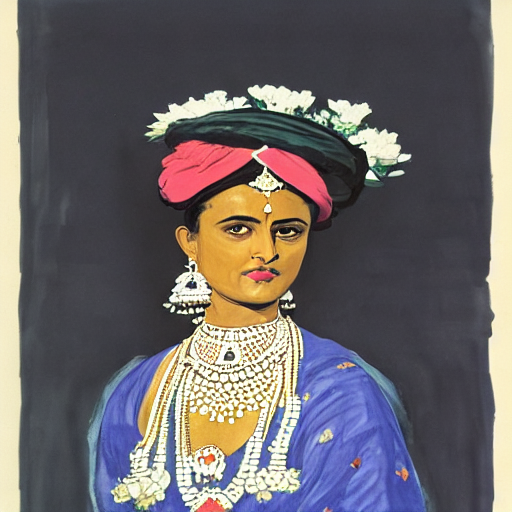

In [ ]:
# with the new token added, we can use the word in the prompt for inference
prompt = "A woman playing in the style of <watercolor-portrait>."
pipe(prompt).images[0]

Dreambooth : A fine-tuning technique to add new capabilities to the trained model. Usually there are tokens which are not used much. So, we could use those tokens to map against some custom images so that usage of those tokens in the prompt conditions the generation of images closer to our custom images.

In [ ]:
# a model has been finetuned to use sks token to generate images of Jeremy Howard
pipe = StableDiffusionPipeline.from_pretrained("pcuenq/jh_dreambooth_1000", torch_dtype=torch.float16)
pipe = pipe.to("cuda")

model_index.json:   0%|          | 0.00/546 [00:00<?, ?B/s]

Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

text_encoder/model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

safety_checker/model.safetensors:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

config.json: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/701 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

scheduler_config.json:   0%|          | 0.00/289 [00:00<?, ?B/s]

unet/diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/917 [00:00<?, ?B/s]

vae/diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/800 [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/738 [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

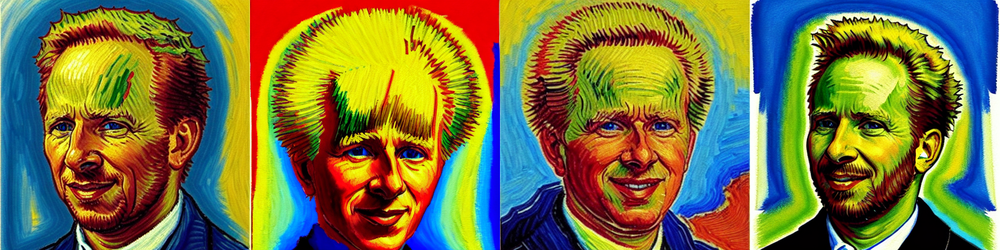

In [ ]:
torch.manual_seed(1000)
# usage of sks conditions the model to generate Jeremy's image.
prompt = "Painting of sks person in the style of Van Gogh"
images = pipe(prompt, num_images_per_prompt=4).images
image_grid(images, 1, 4)

Stable diffusion - three main components [An autoencoder (VAE), Unet, A text encoder]
The output of the Unet is the noise residual which is used to compute a denoised latent image representation via a scheduler algorithm. Three main scheduler types - PNDM scheduler, DDIM scheduler, LMS scheduler.

In Latent Stable diffusion, we are more interested in working in the latent space instead of pixel space to save memory and computational time

In [6]:
# callback functions
vae = pipe.vae
images = []
def latent_callback(i,t,latent):
  latent = 1 / 0.18215 * latent
  image = vae.decode(latent).sample[0]
  image = (image / 2 + 0.5).clamp(0,1)
  image = image.cpu().permute(1,2,0).numpy()
  images.extend(pipe.numpy_to_pil(image))



/usr/local/lib/python3.12/dist-packages/diffusers/pipelines/stable_diffusion/pipeline_stable_diffusion.py:899: FutureWarning: `callback` is deprecated and will be removed in version 1.0.0. Passing `callback` as an input argument to `__call__` is deprecated, consider using `callback_on_step_end`
  deprecate(
/usr/local/lib/python3.12/dist-packages/diffusers/pipelines/stable_diffusion/pipeline_stable_diffusion.py:905: FutureWarning: `callback_steps` is deprecated and will be removed in version 1.0.0. Passing `callback_steps` as an input argument to `__call__` is deprecated, consider using `callback_on_step_end`
  deprecate(


  0%|          | 0/50 [00:00<?, ?it/s]

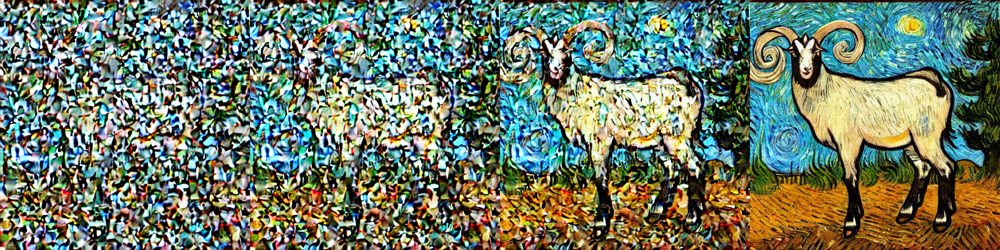

In [8]:
torch.manual_seed(42)
final_image = pipe(prompt, callback = latent_callback, callback_steps = 12).images[0]
image_grid(images, 1, len(images))


In [9]:
del pipe

In [5]:
# building the pipeline ourselves to perform the inference

from transformers import CLIPTextModel, CLIPTokenizer


In [6]:
tokenizer = CLIPTokenizer.from_pretrained("openai/clip-vit-large-patch14", torch_dtype=torch.float16)
text_encoder = CLIPTextModel.from_pretrained("openai/clip-vit-large-patch14", torch_dtype=torch.float16).to("cuda")

tokenizer_config.json:   0%|          | 0.00/905 [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/389 [00:00<?, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

config.json: 0.00B [00:00, ?B/s]

model.safetensors:   0%|          | 0.00/1.71G [00:00<?, ?B/s]

In [7]:
# load the vae and unet
from diffusers import AutoencoderKL, UNet2DConditionModel

# Here we use a different VAE to the original release, which has been fine-tuned for more steps
vae = AutoencoderKL.from_pretrained("stabilityai/sd-vae-ft-ema", torch_dtype=torch.float16).to("cuda")
unet = UNet2DConditionModel.from_pretrained("CompVis/stable-diffusion-v1-4", subfolder="unet", torch_dtype=torch.float16).to("cuda")

config.json:   0%|          | 0.00/547 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

unet/diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

The scheduler used here is the K-LMS scheduler while in the official implementation, PNDM scheduler was used.

Text(0, 0.5, 'Betas')

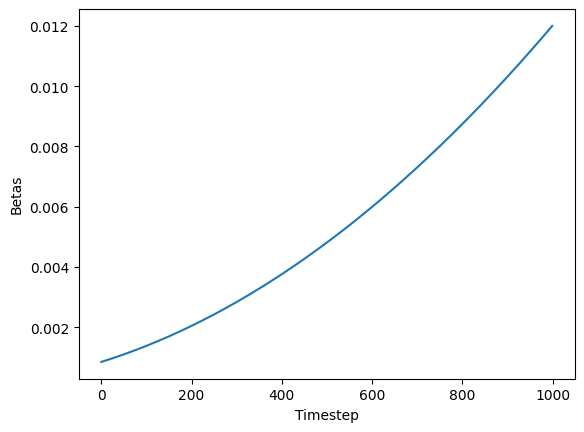

In [8]:
# visualizing the betas of the scheduler
beta_start = 0.00085
beta_end = 0.012
plt.plot(torch.linspace(beta_start**0.5, beta_end ** 0.5, 1000)**2)
plt.xlabel("Timestep")
plt.ylabel("Betas")


In [9]:
from diffusers import LMSDiscreteScheduler # from hf's diffuser library
scheduler = LMSDiscreteScheduler(beta_start = beta_start, beta_end = beta_end, beta_schedule = "scaled_linear", num_train_timesteps = 1000)

In [10]:
# for the same prompt we will use higher number of inference steps and build the inference pipeline step by step
# init arguments
height = 512
width = 512
num_inference_steps = 70
guidance_scale = 7.5
batch_size = 1


In [11]:
text_input = tokenizer(prompt, padding="max_length",max_length=tokenizer.model_max_length, truncation = True, return_tensors = "pt")
text_input['input_ids']

tensor([[49406,  2870,  3086,   539,   320,  9530,  9889,   531,   320,  2677,
           530,   518,  1844,   539,  2451, 19697,   568, 30963,   930, 49407,
         49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
         49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
         49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
         49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
         49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
         49407, 49407, 49407, 49407, 49407, 49407, 49407]])

the first few tokens have appropriate ids and the others have padding ids given by 49407

In [12]:
tokenizer.decode(49407)

'<|endoftext|>'

In [13]:
tokenizer.decode(49406)

'<|startoftext|>'

In [14]:
tokenizer.model_max_length

77

In [15]:
text_input['attention_mask'] # attend only to non-padding tokens which are of interest

tensor([[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0,
         0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
         0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
         0, 0, 0, 0, 0]])

In [16]:
# let us encode the ids to embeddings
text_embeddings = text_encoder(text_input['input_ids'].to('cuda'))[0].half() # half precision for speed
text_embeddings.shape

torch.Size([1, 77, 768])

In [17]:
max_len = text_input.input_ids.shape[-1]
print(max_len)

77


In [18]:
uncond_input = tokenizer([""] * batch_size, padding="max_length", max_length=max_len, return_tensors="pt")
uncond_embeddings = text_encoder(uncond_input.input_ids.to('cuda'))[0].half()
uncond_embeddings.shape

torch.Size([1, 77, 768])

In [19]:
uncond_input.input_ids

tensor([[49406, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
         49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
         49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
         49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
         49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
         49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
         49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
         49407, 49407, 49407, 49407, 49407, 49407, 49407]])

In [20]:
uncond_input.attention_mask

tensor([[1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
         0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
         0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
         0, 0, 0, 0, 0]])

For classifier-free guidance, we need two forward passes - 1. for prompt embeddings and 2. unconditional embeddings. Usually, the latents for the two are concatenated together and passed through a single forward pass

In [21]:
cfg_embeddings = torch.cat([uncond_embeddings, text_embeddings])
cfg_embeddings.shape

torch.Size([2, 77, 768])

In [22]:
torch.manual_seed(42)
latents = torch.randn(
    (batch_size, unet.config.in_channels, height//8, width//8)
)
latents = latents.to("cuda").half()
latents.shape, latents[0].type()


(torch.Size([1, 4, 64, 64]), 'torch.cuda.HalfTensor')

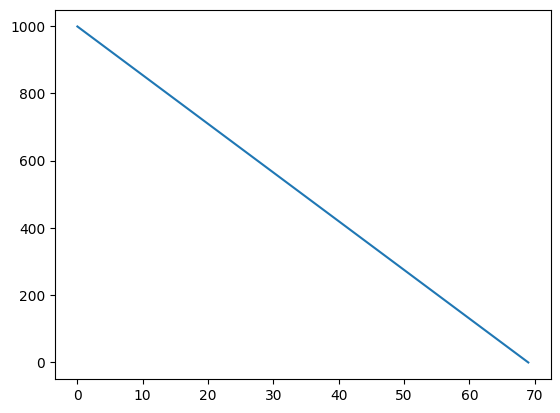

In [23]:
# set timesteps
scheduler.set_timesteps(num_inference_steps)
plt.plot(scheduler.timesteps)

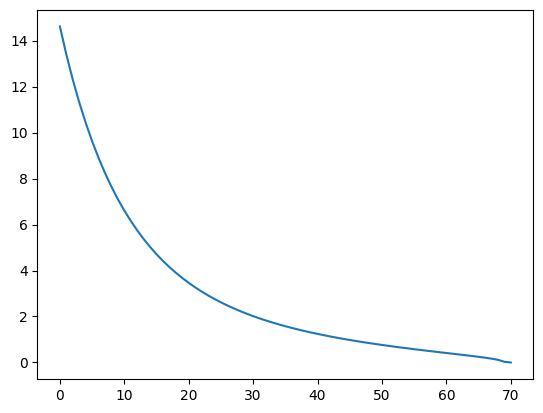

In [24]:
plt.plot(scheduler.sigmas)

In [25]:
# scale the latent initially by the sigma required by the scheduler
latents = latents * scheduler.init_noise_sigma

In [26]:
scheduler.timesteps

tensor([999.0000, 984.5217, 970.0435, 955.5652, 941.0870, 926.6087, 912.1304,
        897.6522, 883.1739, 868.6957, 854.2174, 839.7391, 825.2609, 810.7826,
        796.3043, 781.8261, 767.3478, 752.8696, 738.3913, 723.9130, 709.4348,
        694.9565, 680.4783, 666.0000, 651.5217, 637.0435, 622.5652, 608.0870,
        593.6087, 579.1304, 564.6522, 550.1739, 535.6957, 521.2174, 506.7391,
        492.2609, 477.7826, 463.3044, 448.8261, 434.3478, 419.8696, 405.3913,
        390.9131, 376.4348, 361.9565, 347.4783, 333.0000, 318.5217, 304.0435,
        289.5652, 275.0869, 260.6087, 246.1304, 231.6522, 217.1739, 202.6956,
        188.2174, 173.7391, 159.2609, 144.7826, 130.3044, 115.8261, 101.3478,
         86.8696,  72.3913,  57.9130,  43.4348,  28.9565,  14.4783,   0.0000])

In [28]:
from tqdm.auto import tqdm

In [30]:
for i, t in enumerate(tqdm(scheduler.timesteps)):
  input = torch.cat([latents] * 2)
  input = scheduler.scale_model_input(input, t)

  with torch.no_grad() : noise_residual = unet(input, t, encoder_hidden_states = cfg_embeddings).sample

  pred_uncond, pred_cond = noise_residual.chunk(2)
  pred = pred_uncond + guidance_scale * (pred_cond - pred_uncond)
  latents = scheduler.step(pred, t, latents).prev_sample


  0%|          | 0/70 [00:00<?, ?it/s]

In [31]:
with torch.no_grad() : image = vae.decode(1 / 0.18215 * latents).sample

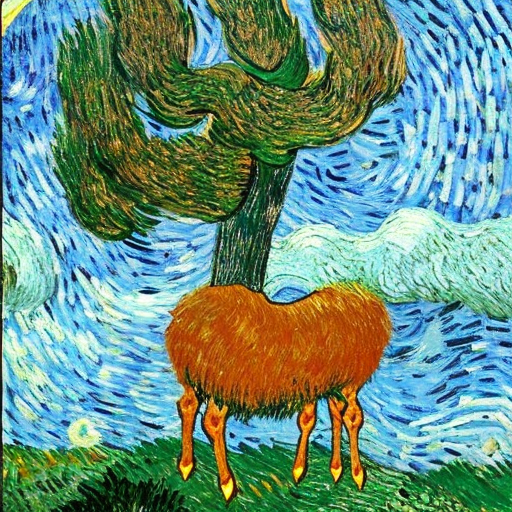

In [32]:
image = (image / 2 + 0.5).clamp(0, 1)
image = image[0].detach().cpu().permute(1, 2, 0).numpy()
image = (image * 255).round().astype("uint8")
Image.fromarray(image)

In [33]:
# let us wrap the entire thing into functions for easier usage
# library imports
from PIL import Image
from IPython.display import display

In [34]:
# text encoder function
def text_encode(prompts, max_len=None):
  if max_len is None : max_len = tokenizer.model_max_length
  inp = tokenizer(prompts, padding="max_length",max_length = max_len, truncation=True,return_tensors ="pt")
  return text_encoder(inp.input_ids.to("cuda"))[0].half()

In [36]:
# initialize latents
def init_latents(batch_size, seed = None):
  if seed is None:
    seed = 42
  torch.manual_seed(seed)
  latents = torch.randn((batch_size, unet.config.in_channels, height//8, width//8)).to("cuda").half()
  latents = latents * scheduler.init_noise_sigma
  return latents

In [65]:
# create images from latents
def create_images(latents):
  with torch.no_grad() : images = vae.decode(1 / 0.18215 * latents).sample
  images = (images / 2 + 0.5).clamp(0, 1)
  images = images.detach().cpu().permute(0,2, 3, 1).numpy()
  images = (images * 255).round().astype("uint8")
  print("Returning images of shape : ", images.shape)
  return images



In [62]:
# display the created images
def display_imgs(imgs):
  for img in imgs:
    display(img)

In [48]:
# the driver function
def create_samples(prompts, num_inference_steps=50):
  batch_size = len(prompts)
  text_embeddings = text_encode(prompts)
  max_len = text_embeddings.shape[1]
  uncond_embeddings = text_encode([""] * batch_size, max_len)
  # concat unconditional and text embeddings from prompts
  cfg_embeddings = torch.cat([uncond_embeddings, text_embeddings])
  # initialize the latents with noise
  latents = init_latents(batch_size)
  # set scheduler timesteps
  scheduler.set_timesteps(num_inference_steps)

  for i, t in enumerate(tqdm(scheduler.timesteps)):
    input = torch.cat([latents] * 2)
    input = scheduler.scale_model_input(input, t)

    with torch.no_grad() : noise_residual = unet(input, t, encoder_hidden_states = cfg_embeddings).sample

    pred_uncond, pred_cond = noise_residual.chunk(2)
    pred = pred_uncond + guidance_scale * (pred_cond - pred_uncond)
    latents = scheduler.step(pred, t, latents).prev_sample
  print("End of creation of samples!")
  print("Latents size : ", latents.size())
  return latents



In [49]:
prompts = [
    "a beautiful deer, spotted, with antlers, background grasslands, bright sunny day, partly cloudy, lush green",
    "a engineer working in a laboratory, white coat, spectacles, gigantic machines, bright light, instrument in hand, coffee cup",
    "a star gazer staring at night sky with a telescope, beautiful starry night, photorealistic, moutain background, near a lake",
]

In [50]:
latents = create_samples(prompts, 70)

torch.Size([3, 4, 64, 64])


  0%|          | 0/70 [00:00<?, ?it/s]

End of creation of samples!
Latents size :  torch.Size([3, 4, 64, 64])


In [66]:
imgs = create_images(latents)

Returning images of shape :  (3, 512, 512, 3)


array([[[242, 236, 228],
        [239, 234, 227],
        [240, 234, 228],
        ...,
        [135, 180, 229],
        [132, 181, 229],
        [138, 182, 225]],

       [[243, 238, 226],
        [243, 236, 228],
        [244, 237, 232],
        ...,
        [137, 182, 230],
        [134, 181, 229],
        [133, 185, 232]],

       [[245, 234, 225],
        [246, 237, 229],
        [245, 237, 230],
        ...,
        [136, 183, 229],
        [136, 183, 231],
        [136, 182, 226]],

       ...,

       [[ 58, 105,  14],
        [ 74, 123,  33],
        [ 91, 144,  49],
        ...,
        [107, 168,  58],
        [101, 161,  51],
        [114, 172,  63]],

       [[ 77, 123,  32],
        [ 73, 121,  30],
        [ 77, 127,  33],
        ...,
        [ 88, 152,  38],
        [120, 189,  74],
        [118, 181,  69]],

       [[ 94, 128,  56],
        [ 99, 150,  54],
        [ 95, 146,  50],
        ...,
        [ 98, 160,  55],
        [119, 184,  80],
        [117, 161,  72]]], dtype=uint8)
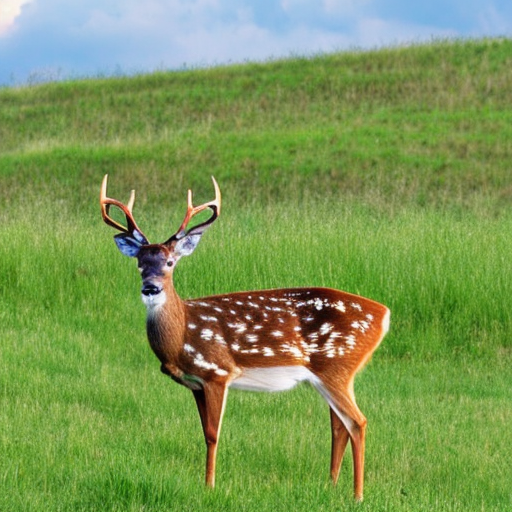

array([[[170, 177, 180],
        [170, 178, 182],
        [169, 178, 182],
        ...,
        [ 14,  18,  28],
        [ 12,  17,  28],
        [ 12,  18,  28]],

       [[169, 176, 181],
        [169, 177, 183],
        [170, 178, 183],
        ...,
        [ 13,  19,  28],
        [ 12,  17,  28],
        [ 13,  18,  28]],

       [[169, 177, 182],
        [170, 177, 184],
        [170, 178, 184],
        ...,
        [ 12,  19,  28],
        [ 12,  19,  28],
        [ 12,  19,  29]],

       ...,

       [[189, 204, 210],
        [189, 204, 212],
        [190, 206, 213],
        ...,
        [ 26,  54,  81],
        [ 27,  56,  81],
        [ 23,  54,  84]],

       [[187, 206, 210],
        [188, 205, 211],
        [190, 205, 212],
        ...,
        [ 25,  53,  82],
        [ 25,  54,  83],
        [ 22,  52,  85]],

       [[190, 204, 210],
        [188, 204, 209],
        [190, 204, 212],
        ...,
        [ 38,  68,  94],
        [ 36,  68,  92],
        [ 35,  60,  85]]], dtype=uint8)
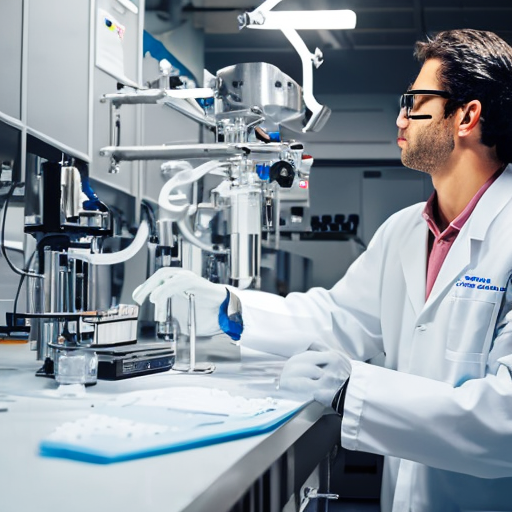

array([[[  0,   2,  15],
        [  1,   0,  20],
        [  3,   4,  21],
        ...,
        [  1,   1,   3],
        [  1,   1,   1],
        [  0,   0,   0]],

       [[  2,   5,  18],
        [  4,   8,  23],
        [  6,   7,  22],
        ...,
        [  2,   2,   3],
        [  0,   0,   1],
        [  1,   1,   2]],

       [[  2,   6,  17],
        [  1,   4,  15],
        [  6,   8,  22],
        ...,
        [  2,   1,   2],
        [  1,   0,   1],
        [  1,   1,   2]],

       ...,

       [[184,  97,  35],
        [177,  89,  31],
        [158,  73,  20],
        ...,
        [ 44,  10,   0],
        [ 51,  23,  11],
        [ 53,  28,  14]],

       [[195, 110,  40],
        [180,  89,  27],
        [142,  52,   2],
        ...,
        [ 54,  16,   4],
        [ 61,  30,  15],
        [ 57,  23,   5]],

       [[159,  86,  30],
        [177, 102,  32],
        [174,  97,  33],
        ...,
        [ 62,  29,  12],
        [ 64,  27,   9],
        [ 67,  37,  16]]], dtype=uint8)
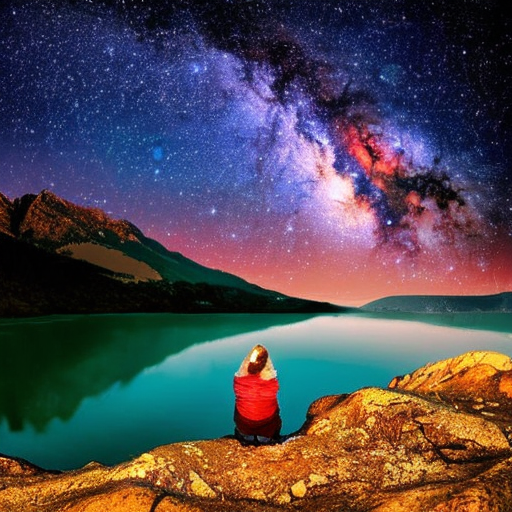

In [67]:
display_imgs(imgs)